In [149]:
import pandas as pd
import numpy as np
import path
import matplotlib.pyplot as plt
import seaborn as sns


# evalution
import sys
sys.path.append("../../")
from Hack.scripts import helper_cross_validate
from Hack.scripts import *

In [81]:
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)


# steps to followed

- look at the data
- simple EDA
- simple Solution (ML model)
- Evalution pipeline
- use this pipeline to evaluate and submit the first solution


In [8]:
DATA_DIR=path.Path("../data/")
ARTIFACT_DIR=path.Path("../artifacts/")

In [191]:
train=pd.read_csv(DATA_DIR+"train.csv")
test=pd.read_csv(DATA_DIR+"test.csv")
train.head()

,loan_id,source,financial_institution,interest_rate,unpaid_principal_bal,loan_term,origination_date,first_payment_date,loan_to_value,number_of_borrowers,debt_to_income_ratio,borrower_credit_score,loan_purpose,insurance_percent,co-borrower_credit_score,insurance_type,m1,m2,m3,m4,m5,m6,m7,m8,m9,m10,m11,m12,m13
0,268055008619,Z,"Turner, Baldwin and Rhodes",4.250,214000,360,2012-03-01,05/2012,95,1.0,22.0,694.0,C86,30.0,0.0,0.0,0,0,0,0,0,0,1,0,0,0,0,0,1
1,672831657627,Y,"Swanson, Newton and Miller",4.875,144000,360,2012-01-01,03/2012,72,1.0,44.0,697.0,B12,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,1,0,1
2,742515242108,Z,Thornton-Davis,3.250,366000,180,2012-01-01,03/2012,49,1.0,33.0,780.0,B12,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,1
3,601385667462,X,OTHER,4.750,135000,360,2012-02-01,04/2012,46,2.0,44.0,633.0,B12,0.0,638.0,0.0,0,0,0,0,0,0,0,0,1,1,1,1,1
4,273870029961,X,OTHER,4.750,124000,360,2012-02-01,04/2012,80,1.0,43.0,681.0,C86,0.0,0.0,0.0,0,1,2,3,4,5,6,7,8,9,10,11,1


In [192]:
test.head()

,loan_id,source,financial_institution,interest_rate,unpaid_principal_bal,loan_term,origination_date,first_payment_date,loan_to_value,number_of_borrowers,debt_to_income_ratio,borrower_credit_score,loan_purpose,insurance_percent,co-borrower_credit_score,insurance_type,m1,m2,m3,m4,m5,m6,m7,m8,m9,m10,m11,m12
0,1,Y,Browning-Hart,3.875,417000,360,01/02/12,Apr-12,75,1,20,790,A23,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2,X,OTHER,4.500,113000,360,01/02/12,Apr-12,80,2,33,793,C86,0,784,0,0,0,0,0,0,0,0,0,0,0,0,0
2,3,Y,OTHER,4.500,72000,360,01/01/12,Mar-12,75,1,34,710,C86,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,4,X,"Miller, Mcclure and Allen",4.125,123000,180,01/02/12,Apr-12,41,2,24,798,A23,0,813,0,0,0,0,0,0,0,0,0,0,0,0,0
4,5,X,Browning-Hart,3.250,166000,180,01/02/12,Apr-12,53,2,12,767,A23,0,768,0,0,0,0,0,0,0,0,0,0,0,0,0


![variables_explanation](D:\experiments\practice_data_science\AVP\Loan\Hack\IMG\variables_explanation.PNG)

In [193]:
train.shape,test.shape

((116058, 29), (35866, 28))

In [16]:
train.nunique()

loan_id                     116058
source                           3
financial_institution           19
interest_rate                  923
unpaid_principal_bal           646
loan_term                      140
origination_date                 3
first_payment_date               4
loan_to_value                   92
number_of_borrowers              2
debt_to_income_ratio            58
borrower_credit_score          221
loan_purpose                     3
insurance_percent               14
co-borrower_credit_score       216
insurance_type                   2
m1                               4
m2                               5
m3                               6
m4                               7
m5                               8
m6                               9
m7                              10
m8                              10
m9                              11
m10                             12
m11                             13
m12                             13
m13                 

In [19]:
test.nunique()

loan_id                     49739
source                          3
financial_institution          19
interest_rate                 607
unpaid_principal_bal          627
loan_term                      77
origination_date                3
first_payment_date              4
loan_to_value                  92
number_of_borrowers             2
debt_to_income_ratio           53
borrower_credit_score         217
loan_purpose                    3
insurance_percent               9
co-borrower_credit_score      214
insurance_type                  2
m1                              4
m2                              5
m3                              6
m4                              6
m5                              7
m6                              7
m7                              8
m8                              7
m9                              8
m10                             9
m11                            10
m12                            11
dtype: int64

In [25]:
train.dtypes

loan_id                       int64
source                       object
financial_institution        object
interest_rate               float64
unpaid_principal_bal          int64
loan_term                     int64
origination_date             object
first_payment_date           object
loan_to_value                 int64
number_of_borrowers         float64
debt_to_income_ratio        float64
borrower_credit_score       float64
loan_purpose                 object
insurance_percent           float64
co-borrower_credit_score    float64
insurance_type              float64
m1                            int64
m2                            int64
m3                            int64
m4                            int64
m5                            int64
m6                            int64
m7                            int64
m8                            int64
m9                            int64
m10                           int64
m11                           int64
m12                         

In [31]:
train.select_dtypes(exclude="object").columns[1:]

Index(['interest_rate', 'unpaid_principal_bal', 'loan_term', 'loan_to_value',
       'number_of_borrowers', 'debt_to_income_ratio', 'borrower_credit_score',
       'insurance_percent', 'co-borrower_credit_score', 'insurance_type', 'm1',
       'm2', 'm3', 'm4', 'm5', 'm6', 'm7', 'm8', 'm9', 'm10', 'm11', 'm12',
       'm13'],
      dtype='object')

## check for class imabalance

In [34]:
train['m13'].value_counts()

0    115422
1       636
Name: m13, dtype: int64

## Lets ask some interesting questions

In [37]:
source_inst_df=train.groupby(["source","financial_institution"]).sum()[train.select_dtypes(exclude="object").columns[1:]]#[train.columns[1:].tolist()]
source_inst_df

interest_rate  unpaid_principal_bal  \
source financial_institution                                              
X      Anderson-Taylor                   1117.125              44079000   
       Browning-Hart                    44135.250            2514489000   
       Chapman-Mcmahon                   1242.780              98174000   
       Cole, Brooks and Vincent          1426.935              65756000   
       Edwards-Hoffman                    492.182              20031000   
       Martinez, Duffy and Bird         11397.945             607300000   
       Miller, Mcclure and Allen        10251.364             519317000   
       Nicholson Group                   2220.500             111919000   
       OTHER                           146203.797            7305204000   
       Richardson Ltd                    1705.500              80515000   
       Romero, Woods and Johnson         2674.750             132500000   
       Sanchez, Hays and Wilkerson        207.500              13531000   
       Suarez Inc                        4009.335             221768000   
       Swanson, Newton and Miller       15585.250             778101000   
       Taylor, Hunt and Rodriguez        2342.800             103614000   
       Thornton-Davis                     143.875               8690000   
       Turner, Baldwin and Rhodes         352.750              17258000   
Y      Anderson-Taylor                    821.125              40472000   
       Browning-Hart                    71269.585            3936362000   
       Cole, Brooks and Vincent          3966.030             180848000   
       Edwards-Hoffman                  13036.520             780684000   
       Martinez, Duffy and Bird          6683.215             313704000   
       Miller, Mcclure and Allen          242.705              13272000   
       Nicholson Group                   3272.575             201865000   
       OTHER                            23078.040            1114475000   
       Richards-Walters                  1409.375              79863000   
       Sanchez, Hays and Wilkerson        155.000              10360000   
       Sanchez-Robinson                  3882.750             163978000   
       Suarez Inc                        1140.750              59764000   
       Swanson, Newton and Miller       12131.590             751081000   
       Taylor, Hunt and Rodriguez         676.930              45684000   
       Thornton-Davis                      88.875               5970000   
       Turner, Baldwin and Rhodes        5358.875             266065000   
Z      Anderson-Taylor                    105.500               5914000   
       Browning-Hart                    11238.989             749808000   
       Cole, Brooks and Vincent          1386.480              84054000   
       Edwards-Hoffman                   5130.006             324566000   
       Martinez, Duffy and Bird           178.125               5737000   
       Miller, Mcclure and Allen         2028.140             146115000   
       Nicholson Group                   2408.000             173567000   
       OTHER                            19794.360            1149166000   
       Richards-Walters                  4086.250             255485000   
       Sanchez, Hays and Wilkerson       2948.875             210866000   
       Suarez Inc                        1694.530             115562000   
       Taylor, Hunt and Rodriguez        1900.010             135759000   
       Thornton-Davis                    1970.375             129925000   
       Turner, Baldwin and Rhodes        1430.625              73102000   

                                    loan_term  loan_to_value  \
source financial_institution                                   
X      Anderson-Taylor                  93960          18013   
       Browning-Hart                  3330672         739025   
       Chapman-Mcmahon                  56520          19645   
       Cole, Brooks and Vincent        1

array([<matplotlib.axes._subplots.AxesSubplot object at 0x00000252250BAD68>,
      dtype=object)

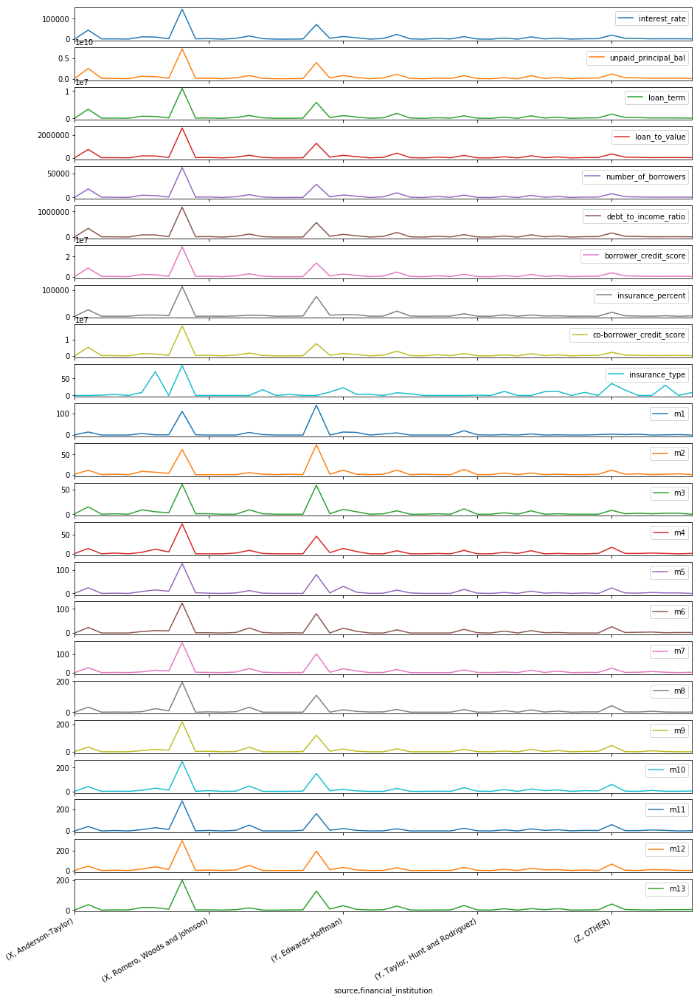

In [46]:
source_inst_df.plot(subplots=True,figsize=(15,25))

In [50]:
source_inst_df[source_inst_df.m13==source_inst_df.m13.max()]

,,interest_rate,unpaid_principal_bal,loan_term,loan_to_value,number_of_borrowers,debt_to_income_ratio,borrower_credit_score,insurance_percent,co-borrower_credit_score,insurance_type,...,m4,m5,m6,m7,m8,m9,m10,m11,m12,m13
source,financial_institution,,,,,,,,,,,,,,,,,,,,,
X,OTHER,146203.797,7305204000,10977503,2602832,62311.0,1166723.0,29754122.0,114186.0,18300721.0,88.0,...,78,127,124,165,194,219,252,276,303,201


In [53]:
def color_negative_red(val):
    """
    Takes a scalar and returns a string with
    the css property `'color: red'` for negative
    strings, black otherwise.
    """
    color = 'red' if val > 10 else 'black'
    return 'color: %s' % color


In [54]:
source_inst_df_view1 = source_inst_df.style.applymap(color_negative_red)
source_inst_df_view1


In [56]:
def highlight_max(s):
    '''
    highlight the maximum in a Series yellow.
    '''
    
    is_max = s == s.max()
    return ['background-color: yellow' if v else '' for v in is_max]

source_inst_df_view2=source_inst_df.style.apply(highlight_max)
source_inst_df_view2

In [82]:
def highlight_max_top10(s):
    '''
    highlight the maximum in a Series yellow.
    '''
    top10=s.sort_values(ascending=False).values[:10]
    is_top10 = s.isin(top10.tolist())
    return ['background-color: green' if v else '' for v in is_top10]

source_inst_df_view3=source_inst_df.style.apply(highlight_max_top10)
source_inst_df_view3

## First insight

- We are able to understand that the row which has maximum values (in all columns) have maximum delegancy
- ANd most of the maximum rows comes from OTHER option (due to lack of data or privacy reasons)

- Both this insights makes sense atleast this point of time

In [85]:
train.set_index("loan_id",inplace=True)

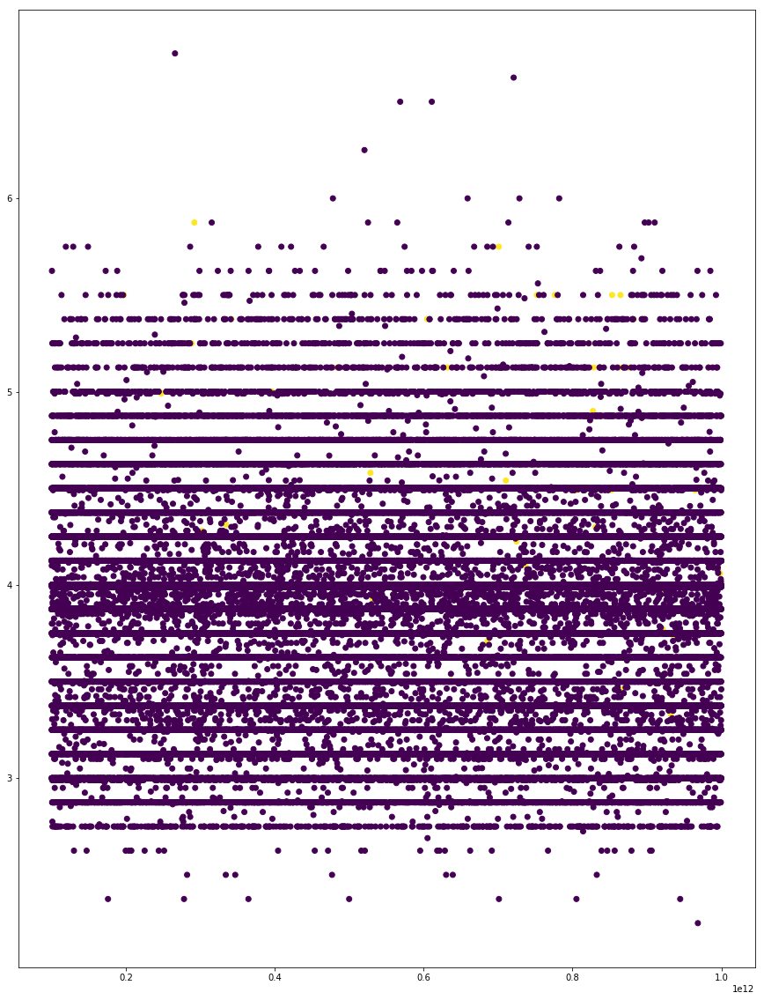

In [92]:
plt.figure(figsize=(15,20))
plt.scatter(train.index,train.interest_rate,c=train.m13)
plt.show()

In [105]:
train.iloc[:500,-13:].style.apply(highlight_max_top10)

,m1,m2,m3,m4,m5,m6,m7,m8,m9,m10,m11,m12,m13
loan_id,,,,,,,,,,,,,
268055008619,0,0,0,0,0,0,1,0,0,0,0,0,1
672831657627,0,0,0,0,0,0,0,0,0,0,1,0,1
742515242108,0,0,0,0,0,0,0,0,0,0,0,0,1
601385667462,0,0,0,0,0,0,0,0,1,1,1,1,1
273870029961,0,1,2,3,4,5,6,7,8,9,10,11,1
769060024464,1,0,0,0,0,0,0,0,0,0,0,0,1
148071614687,0,0,0,0,0,0,0,0,0,0,0,0,1
853383953266,0,1,0,0,0,0,0,0,0,0,0,0,1
423590072335,0,0,0,0,1,0,1,0,1,2,0,1,1


In [106]:
train.iloc[500:1000,-13:].style.apply(highlight_max_top10)

,m1,m2,m3,m4,m5,m6,m7,m8,m9,m10,m11,m12,m13
loan_id,,,,,,,,,,,,,
500848226864,0,0,0,0,0,0,0,0,0,0,0,0,1
927756775108,0,0,0,0,0,0,0,0,0,0,0,0,1
549929391638,0,0,0,0,0,1,1,2,2,3,4,4,1
253047131849,1,2,1,0,1,2,3,4,5,6,7,8,1
231661308911,0,0,0,0,1,0,0,0,0,0,0,0,1
247495105383,0,0,0,1,1,0,0,1,1,1,0,1,1
221853347646,0,0,0,1,2,0,1,2,3,4,0,1,1
232756268394,0,0,0,0,0,0,0,0,0,0,0,0,1
603708094788,0,0,0,0,1,1,0,0,1,1,1,2,1


In [108]:
train.iloc[2000:10000,-13:].style.apply(highlight_max_top10)

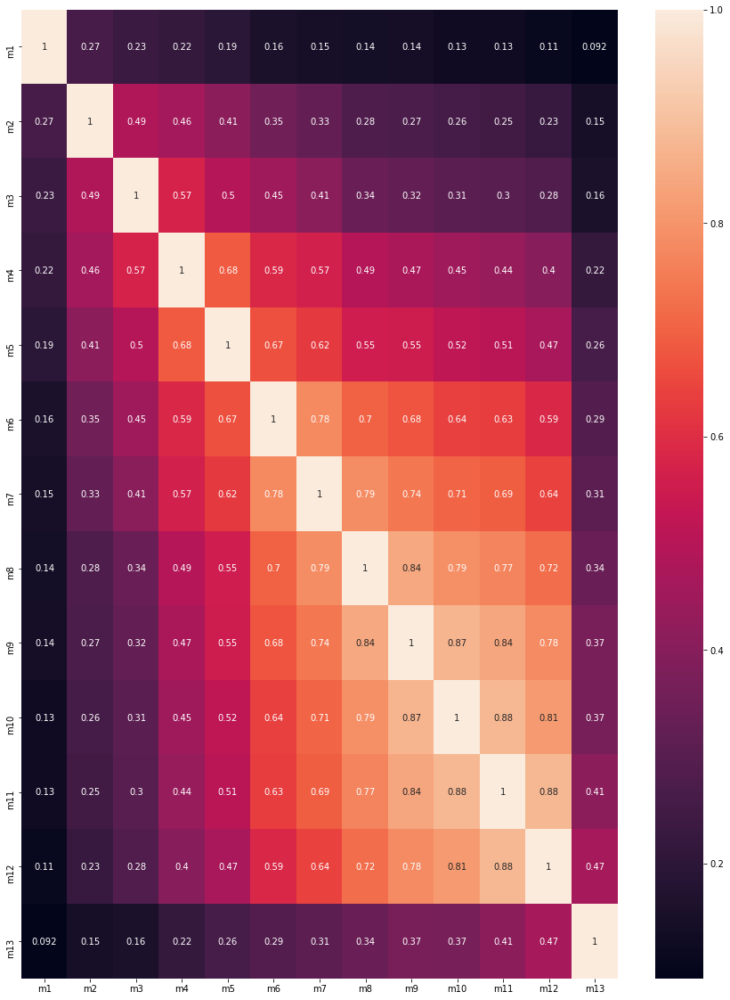

In [99]:
plt.figure(figsize=(15,20))
sns.heatmap(train[train.columns[-13:]].corr(),annot=True)

## Inisghts 2

- Merely by looking at the (12) months delegancy we can able to somewhat predict the delegancy of next month (13th)

## implement Rule based or simple model based only on 12 month columns

In [133]:
X=train[train.columns[-13:-1]]
np.where(X>2,1,0)

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [134]:
X[]

,m1,m2,m3,m4,m5,m6,m7,m8,m9,m10,m11,m12
loan_id,,,,,,,,,,,,
268055008619,0,0,0,0,0,0,1,0,0,0,0,0
672831657627,0,0,0,0,0,0,0,0,0,0,1,0
742515242108,0,0,0,0,0,0,0,0,0,0,0,0
601385667462,0,0,0,0,0,0,0,0,1,1,1,1
273870029961,0,1,2,3,4,5,6,7,8,9,10,11
769060024464,1,0,0,0,0,0,0,0,0,0,0,0
148071614687,0,0,0,0,0,0,0,0,0,0,0,0
853383953266,0,1,0,0,0,0,0,0,0,0,0,0
423590072335,0,0,0,0,1,0,1,0,1,2,0,1


In [168]:
from sklearn.ensemble import RandomForestClassifier
train_rf=lambda x1,x2,x3,x4:RandomForestClassifier(class_weight={0:0.4,1:0.6}).fit(x1,x2)

C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


0.0


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


0.0


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


0.0


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


0.0


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


0.0


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


0.0


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


0.0


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


0.0


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


0.0


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


0.0


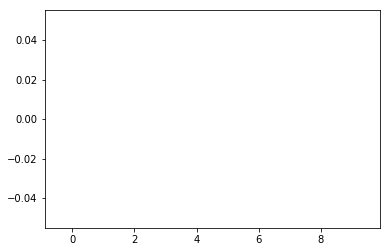

In [142]:
helper_cross_validate(X,train['m13'],train_model=train_rf)

In [161]:
from Hack.scripts.evaluate import KFold,f1_score,evaluate
from collections import Counter

C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Class label 1 not present.
0.5903083700440528


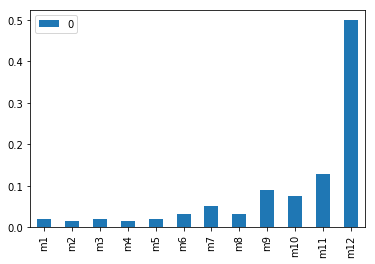

Counter({0: 11334, 1: 272}) Counter({0: 10970, 1: 636})


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


0.0


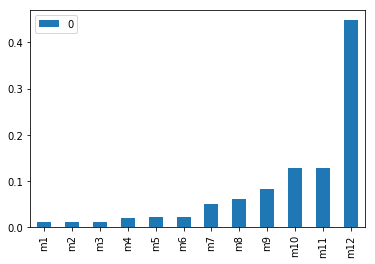

Counter({0: 11597, 1: 9}) Counter({0: 11606})


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


0.0


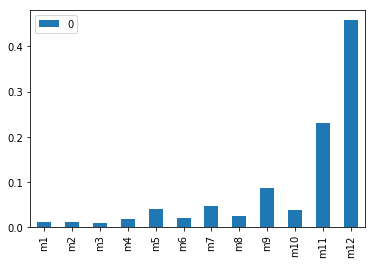

Counter({0: 11595, 1: 11}) Counter({0: 11606})


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


0.0


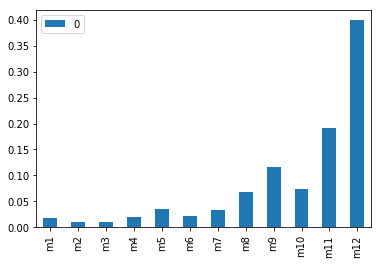

Counter({0: 11593, 1: 13}) Counter({0: 11606})


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


0.0


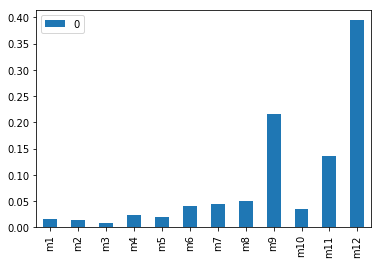

Counter({0: 11598, 1: 8}) Counter({0: 11606})


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


0.0


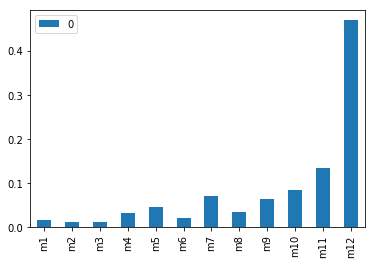

Counter({0: 11601, 1: 5}) Counter({0: 11606})


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


0.0


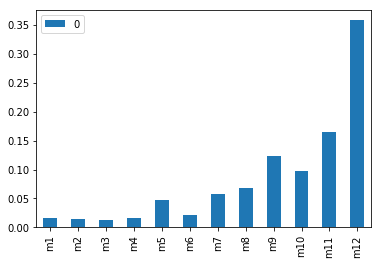

Counter({0: 11597, 1: 9}) Counter({0: 11606})


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


0.0


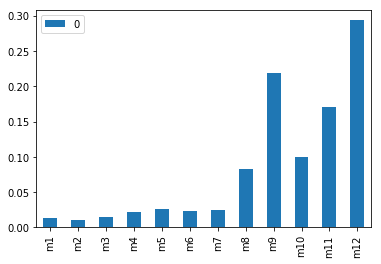

Counter({0: 11598, 1: 8}) Counter({0: 11606})


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


0.0


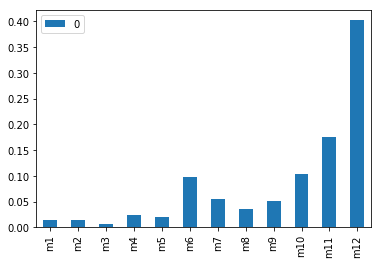

Counter({0: 11599, 1: 6}) Counter({0: 11605})


C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


0.0


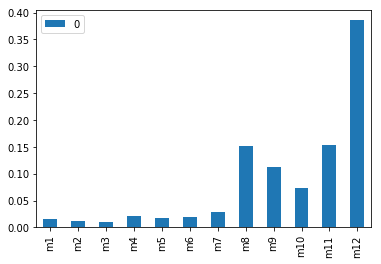

Counter({0: 11592, 1: 13}) Counter({0: 11605})


In [173]:
y=train['m13']
kf=KFold(n_splits=10)
score_list=[]
for train_index,test_index in kf.split(X):
  X_train,X_test=X.iloc[train_index],X.iloc[test_index]
  y_train,y_test=y.iloc[train_index],y.iloc[test_index]
#   if pass_val:
#     model=train_model(model,X_train,y_train,X_test,y_test)
#   else:
#     model=train_model(model,X_train,y_train)
  try:
      model=train_rf(X_train,y_train,X_test,y_test)
  except ValueError as e:
    print(e)
    pass
  pred=model.predict(X_test)
  score=evaluate(y_test,pred)
  print(score)
  pd.DataFrame(model.feature_importances_,index=X.columns).plot(kind='bar')
  plt.show()
  print(Counter(pred),Counter(y_test))

In [158]:
score

0.0

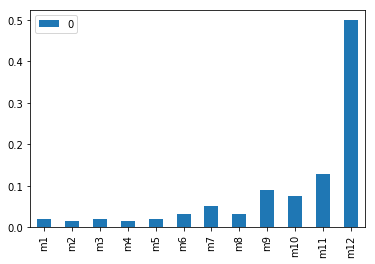

In [172]:
pd.DataFrame(model.feature_importances_,index=X.columns).plot(kind='bar')

In [163]:
Counter(pred),Counter(y_test)

(Counter({0: 11595, 1: 10}), Counter({0: 11605}))

In [176]:
rf=train_rf(X,y,1,1)

C:\Users\gurunath.lv\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


In [178]:
test[test.columns[-12:]]

,m1,m2,m3,m4,m5,m6,m7,m8,m9,m10,m11,m12
0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0
2,0,1,0,0,0,0,0,0,0,0,1,1
3,0,0,0,0,0,0,0,0,0,0,1,0
4,0,0,0,0,0,1,2,1,1,2,1,2
5,0,0,0,0,0,0,1,1,1,1,1,1
6,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,1,2,1,1
8,0,0,0,0,0,0,0,0,0,1,2,3
9,0,0,0,0,0,0,0,0,0,0,0,0


In [195]:
pred=rf.predict(test[test.columns[-12:]])

In [196]:
submission=pd.DataFrame()
submission['loan_id']=test['loan_id']
submission['m13']=pred

In [200]:
test.shape,submission.shape

((35866, 28), (35866, 2))

In [202]:
submission.to_csv(DATA_DIR+"submission_rf.csv",index=False)

In [203]:
test['loan_id']

0            1
1            2
2            3
3            4
4            5
5            6
6            7
7            8
8            9
9           10
10          11
11          12
12          13
13          14
14          15
15          16
16          17
17          18
18          19
19          20
20          21
21          22
22          23
23          24
24          25
25          26
26          27
27          28
28          29
29          30
30          31
31          32
32          33
33          34
34          35
35          36
36          37
37          38
38          39
39          40
40          41
41          42
42          43
43          44
44          45
45          46
46          47
47          48
48          49
49          50
         ...  
35816    35817
35817    35818
35818    35819
35819    35820
35820    35821
35821    35822
35822    35823
35823    35824
35824    35825
35825    35826
35826    35827
35827    35828
35828    35829
35829    35830
35830    35831
35831    3

In [204]:
test['m13_Rf']=pred

In [206]:
test.to_csv(DATA_DIR+"explore_rf_test.csv")